## Adagrad, RMSProp, and Adam (Practical Work 4)

For this practical work, the student will have to develop a Python program that is able to implement the accelerated gradient descent methods with adaptive learning rate <b>(Adagrad, RMSProp, and Adam)</b> in order to achieve the linear regression of a set of datapoints.
##### Please notice that we will apply these algorithm to single variable LR.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline

To have a dataset or set of data points, the student must generate a pair of arrays <b>X</b> and <b>y</b> with the values in <b>X</b> equally distributed between <b>0</b> and <b>20</b> and the values in <b>y</b> such that: 
<b>yi = a*xi + b (and a = -1, b = 2)</b>


In [ ]:
X = np.linspace(0,20)
X

array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])

In [ ]:
a=-1
b=2
y=a*X+b
y

array([  2.        ,   1.59183673,   1.18367347,   0.7755102 ,
         0.36734694,  -0.04081633,  -0.44897959,  -0.85714286,
        -1.26530612,  -1.67346939,  -2.08163265,  -2.48979592,
        -2.89795918,  -3.30612245,  -3.71428571,  -4.12244898,
        -4.53061224,  -4.93877551,  -5.34693878,  -5.75510204,
        -6.16326531,  -6.57142857,  -6.97959184,  -7.3877551 ,
        -7.79591837,  -8.20408163,  -8.6122449 ,  -9.02040816,
        -9.42857143,  -9.83673469, -10.24489796, -10.65306122,
       -11.06122449, -11.46938776, -11.87755102, -12.28571429,
       -12.69387755, -13.10204082, -13.51020408, -13.91836735,
       -14.32653061, -14.73469388, -15.14285714, -15.55102041,
       -15.95918367, -16.36734694, -16.7755102 , -17.18367347,
       -17.59183673, -18.        ])

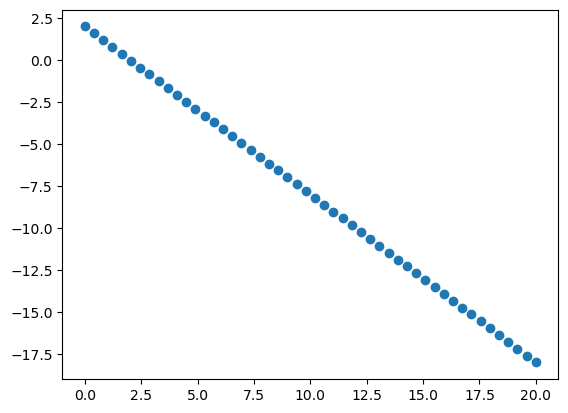

In [ ]:
plt.scatter(X,y)
plt.show()

In [ ]:
def Epoch_loss(loss):
    plt.plot(loss ,'-mo')
    plt.style.use('seaborn')
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.show()
    

def Thetas_loss(Theta_0,Theta_1,loss,alpha):
    #Theta_0
    plt.plot(Theta_0,loss ,marker ='o',color = 'purple')
    plt.style.use('seaborn')
    plt.xlabel("Theta_0")
    plt.ylabel("Loss")
    plt.title(f"Learing Rate = {alpha}")
    plt.show()
    #Theta_1
    plt.plot(Theta_1,loss ,marker ='o',color = 'purple')
    plt.style.use('seaborn')
    plt.xlabel("Theta_1")
    plt.ylabel("Loss")
    plt.title(f"Learing Rate = {alpha}")
    plt.show()
    
    
def All_lines(X,y,H):
    plt.scatter(X,y,label="y_actual")
    for j in range(0,len(H)):
        plt.plot(X,H[j] ,color='red')

    plt.xlabel("X")
    plt.ylabel("y")
    plt.show()
    
    
def best_Line(X,y,h_x):
    plt.scatter(X,y,label="y_actual")
    plt.plot(X,h_x ,color='red',label="y_predict h(x)")
    plt.xlabel("X")
    plt.ylabel("y")
    plt.legend()
    plt.show()
    

### For a single variable linear regression ML model, build a function to find the optimum Theta_0 and Theta_1 parameters using Adagrad optimization algorithm.
#### The funtion should have the following input parameters:
##### 1. Input data as a matrix (or vector based on your data).
##### 2. Target label as a vector.
##### 3. Learning rate.
##### 4. Epsilon.
##### 5. Maximum number of iterations (Epochs).
#### The funtion should return the following outputs:
##### 1. All predicted Theta_0 in all iterations.
##### 2. All predicted Theta_1 in all iterations.
##### 3. Corresponding loss for each Theta_0 and Theta_1 predictions.
##### 4.All hypothesis outputs (prdicted labels) for each Theta_0 and Theta_1 predictions.
##### 5.Final Optimum values of Theta_0 and Theta_1.
#### Choose the suitable number of iterations, learning rate, Epsilon, and stop criteria.
#### Calculate r2 score. Shouldn't below 0.9
#### Plot the required curves (loss-epochs, loss-theta0, loss-theta1, all fitted lines per epoch (single graph), best fit line)
#### Try different values of the huperparameters and see the differnce in your results.

In [ ]:
from math import sqrt
from sklearn.metrics import r2_score

In [ ]:
def Adagrad(X ,y , alpha , E ,max_it):
    theta_0 , theta_1 , V_0 ,V_1 = 0,0,0,0
    loss=[]
    Theta_0=[]
    Theta_1=[]
    H =[]
    
    for i in range(max_it):
        print(f"\n****************** Iteration {i} ********************")
        Theta_0.append(theta_0)
        Theta_1.append(theta_1)
        h_x = theta_0 + theta_1 * X
        H.append(h_x)
        print("h(x):" ,h_x)
        err=(h_x - y)
        m_2 = 2*len(X)
        j = 1/m_2 * sum(err**2)
        loss.append(j)
        print("\nError Vector:\n" , err)
        print("\nj = " ,j)
        d_theta_0=  1/len(X) * sum((err))
        d_theta_1= 1/len(X) * sum((err)* X)
        G_V= np.array([[d_theta_0],
                       [d_theta_1]])
        print("\nGradient Vector :\n",G_V)
        G_norm = np.linalg.norm(G_V)
        print("\nGradient Vector Norm :\n",G_norm)
        
        
        
        
        if i >2 and abs(loss[-1] -loss[-2]) <= 0.001:
                break
    
        if G_norm <= 0.001 :
            break
        
        V_0 = V_0 + (d_theta_0 ** 2) 
        theta_0 = theta_0 - ( alpha/(sqrt(V_0)+E) ) * d_theta_0
        
        V_1 = V_1 + (d_theta_1 ** 2) 
        theta_1 = theta_1 - ( alpha/(sqrt(V_1)+E) ) * d_theta_1
        
        
        print("\ntheta_0_new : ",theta_0)
        print("theta_1_new : ",theta_1)
        
        
    # ****************** Training Report ********************
    print("\n****************** Training Report ********************")
    print(f"\nGradient Descent converged after {i+1} iterations")
    print("\ntheta_0_Opt : " ,theta_0)
    print("theta_1_Opt : " ,theta_1)
    print("\nError Vector: ",err)
    print("\ncost : ",j)
    print("\nh(x) = y_predict: \n" ,h_x)
    print("\ny_actual:\n" , y)
    print()    
        
    return Theta_0, Theta_1 , H ,  loss
    


##### The following results uses alpha = 0.05, epsilon =  1e-08, and max. iterations = 500.

In [ ]:
Theta_0, Theta_1 , H ,  loss = Adagrad(X,y,0.05, 1e-8 , 500)


****************** Iteration 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j =  49.34693877551021

Gradient Vector :
 [[  8.        ]
 [114.69387755]]

Gradient Vector Norm :
 114.97254258164628

theta_0_new :  -0.0499999999375
theta_1_

In [ ]:
r2_score(y,H[-1])

0.9484638125790851

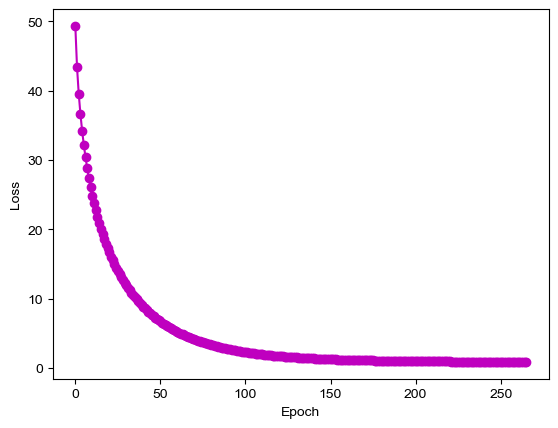

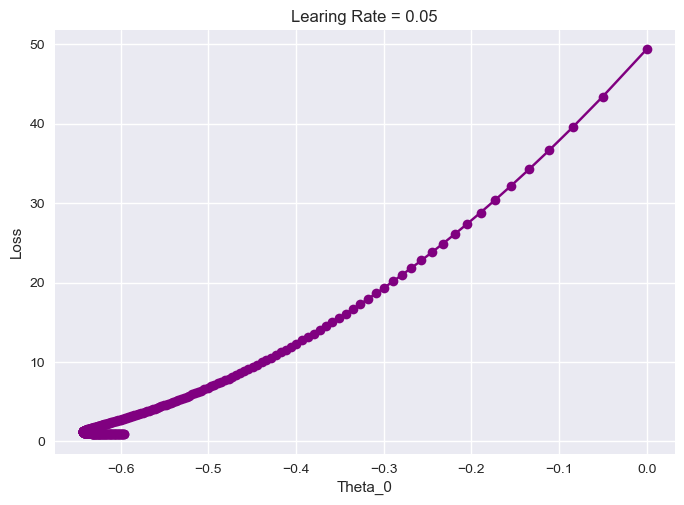

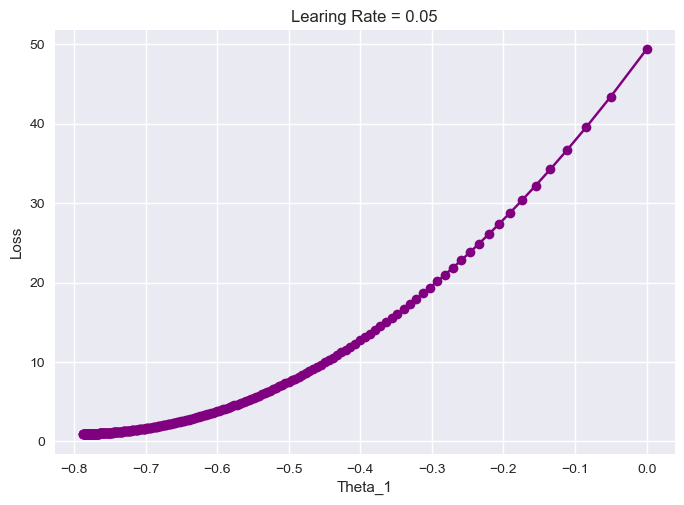

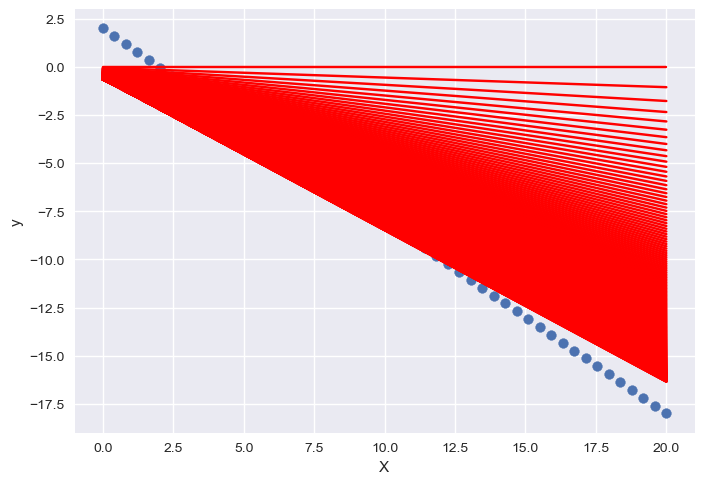

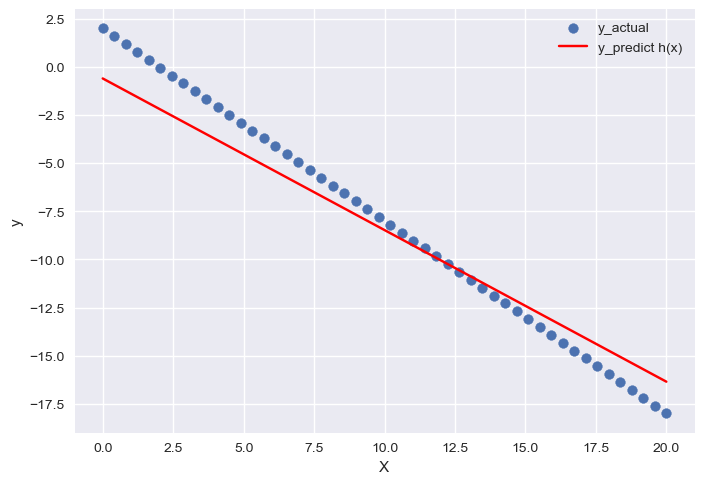

In [ ]:
Epoch_loss(loss)
Thetas_loss(Theta_0,Theta_1,loss,0.05)
All_lines(X,y,H)
best_Line(X,y,H[-1])

##### The following results uses alpha = 0.005, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
Theta_0, Theta_1 , H ,  loss = Adagrad(X,y,0.005, 1e-8 , 5000)


****************** Iteration 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j =  49.34693877551021

Gradient Vector :
 [[  8.        ]
 [114.69387755]]

Gradient Vector Norm :
 114.97254258164628

theta_0_new :  -0.00499999999375
theta_1

In [ ]:
r2_score(y,H[-1])

0.7095974929894115

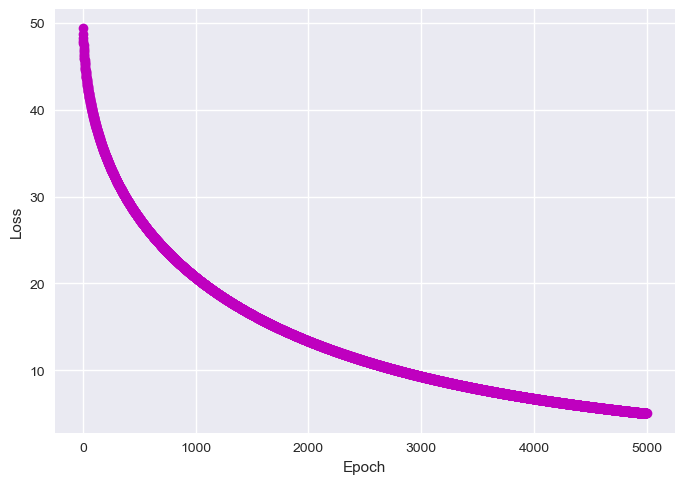

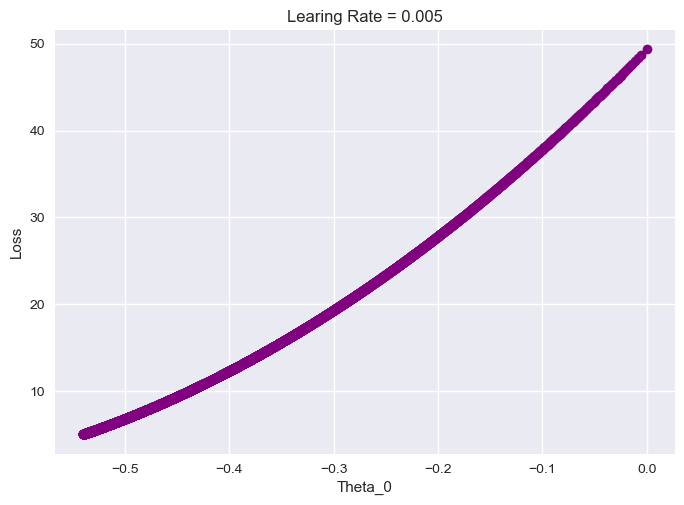

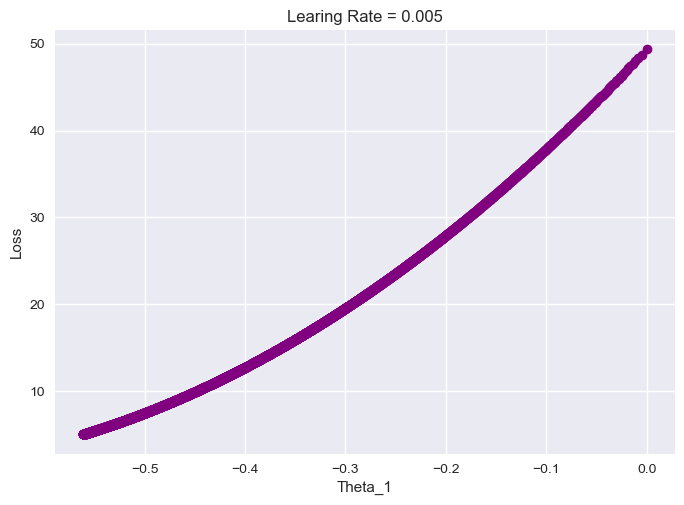

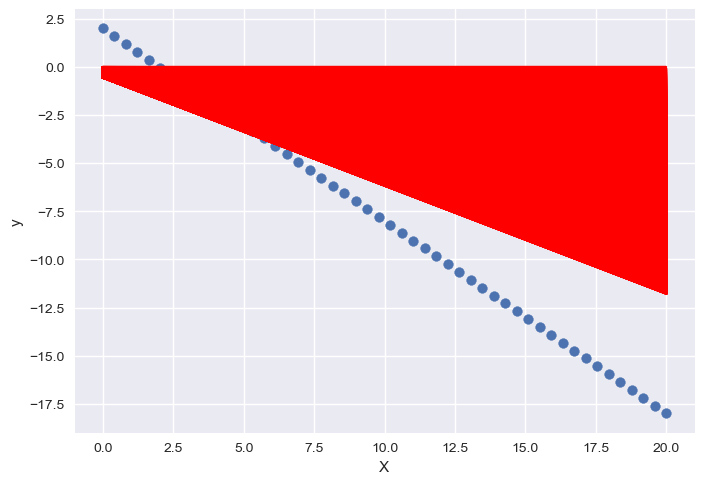

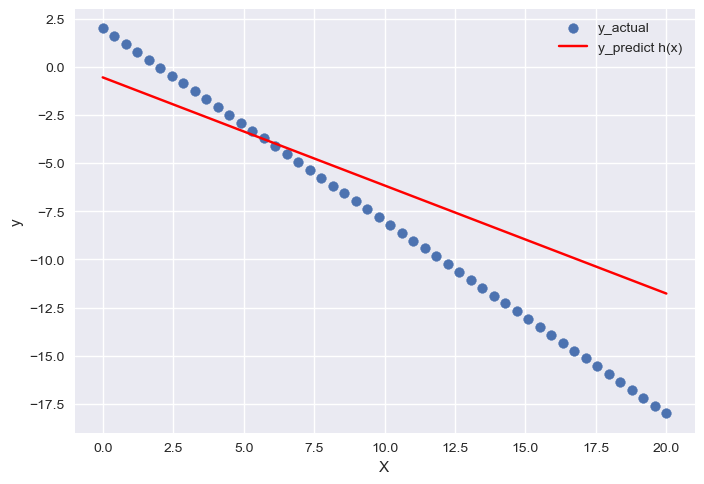

In [ ]:
Epoch_loss(loss)
Thetas_loss(Theta_0,Theta_1,loss,0.005)
All_lines(X,y,H)
best_Line(X,y,H[-1])

##### The following results uses alpha = 0.0005, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
Theta_0, Theta_1 , H ,  loss = Adagrad(X,y,0.0005, 1e-8 , 5000)


****************** Iteration 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j =  49.34693877551021

Gradient Vector :
 [[  8.        ]
 [114.69387755]]

Gradient Vector Norm :
 114.97254258164628

theta_0_new :  -0.000499999999375
theta_

In [ ]:
r2_score(y,H[0])

-1.8447058823529408

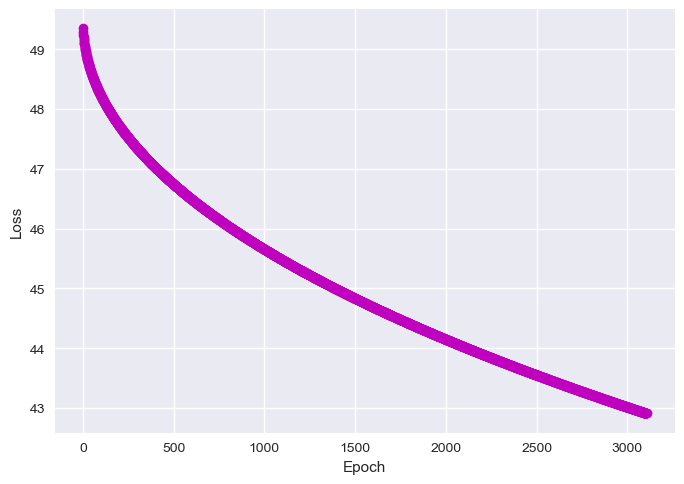

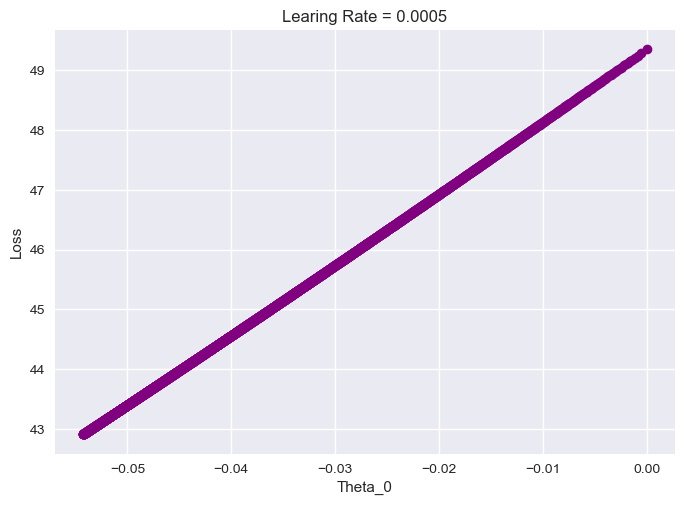

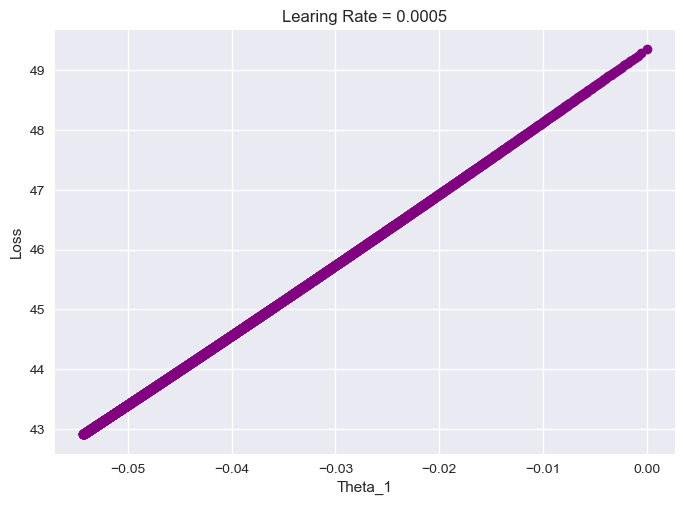

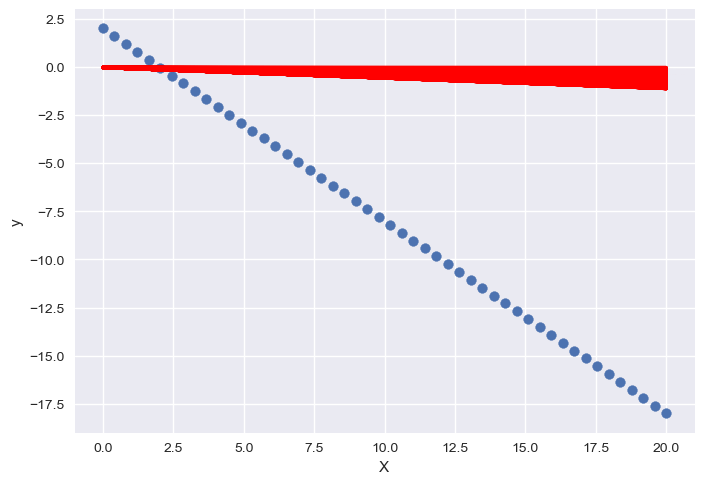

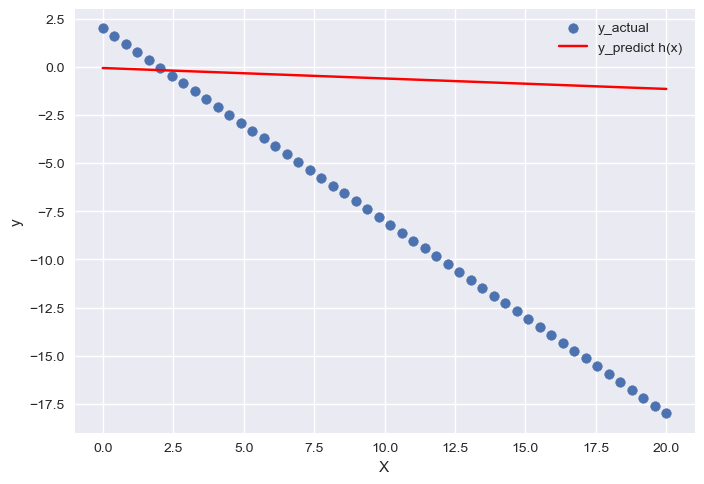

In [ ]:
Epoch_loss(loss)
Thetas_loss(Theta_0,Theta_1,loss,0.0005)
All_lines(X,y,H)
best_Line(X,y,H[-1])

## RMSProp

### Update the previos implementation to be RMSProp.
#### Compare your results with Adagrad results.

In [ ]:
def RMSProp(X ,y , alpha, B , E ,max_it):
    theta_0 , theta_1 , V_0 ,V_1 = 0,0,0,0
    loss=[]
    Theta_0=[]
    Theta_1=[]
    H =[]
    
    for i in range(max_it):
        print(f"\n****************** Iteration {i} ********************")
        Theta_0.append(theta_0)
        Theta_1.append(theta_1)
        h_x = theta_0 + theta_1 * X
        H.append(h_x)
        print("h(x):" ,h_x)
        err=(h_x - y)
        m_2 = 2*len(X)
        j = 1/m_2 * sum(err**2)
        loss.append(j)
        print("\nError Vector:\n" , err)
        print("\nj = " ,j)
        d_theta_0=  1/len(X) * sum((err))
        d_theta_1= 1/len(X) * sum((err)* X)
        G_V= np.array([[d_theta_0],
                       [d_theta_1]])
        print("\nGradient Vector :\n",G_V)
        G_norm = np.linalg.norm(G_V)
        print("\nGradient Vector Norm :\n",G_norm)
        
        
        
        
        if i >2 and abs(loss[-1] -loss[-2]) <= 0.001:
            break
    
        if G_norm <= 0.001 :
            break
        
        V_0 = B * V_0 + (1-B)*(d_theta_0 ** 2) 
        theta_0 = theta_0 - ( alpha/(sqrt(V_0)+E) ) * d_theta_0
        
        V_1 = B *V_1 + (1-B)*(d_theta_1 ** 2) 
        theta_1 = theta_1 - ( alpha/(sqrt(V_1)+E) ) * d_theta_1
        
        
        print("\ntheta_0_new : ",theta_0)
        print("theta_1_new : ",theta_1)
        
        
    # ****************** Training Report ********************
    print("\n****************** Training Report ********************")
    print(f"\nGradient Descent converged after {i+1} iterations")
    print("\ntheta_0_Opt : " ,theta_0)
    print("theta_1_Opt : " ,theta_1)
    print("\nError Vector: ",err)
    print("\ncost : ",j)
    print("\nh(x) = y_predict: \n" ,h_x)
    print("\ny_actual:\n" , y)
    print()    
        
    return Theta_0, Theta_1 , H ,  loss
    


##### The following results uses alpha = 0.05, beta = 0.9, epsilon =  1e-08, and max. iterations = 500.

In [ ]:
Theta_0, Theta_1 , H ,  loss = RMSProp(X,y, 0.05 , 0.9, 1e-8 , 500)


****************** Iteration 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j =  49.34693877551021

Gradient Vector :
 [[  8.        ]
 [114.69387755]]

Gradient Vector Norm :
 114.97254258164628

theta_0_new :  -0.158113882383419
theta_

In [ ]:
r2_score(y,H[-1])

0.9993602095484941

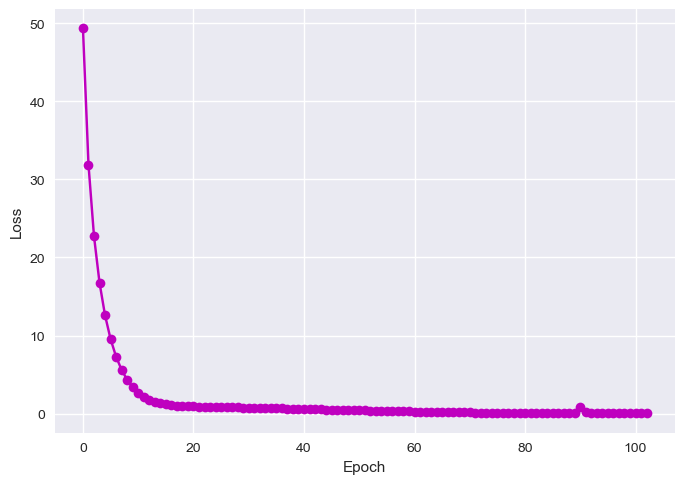

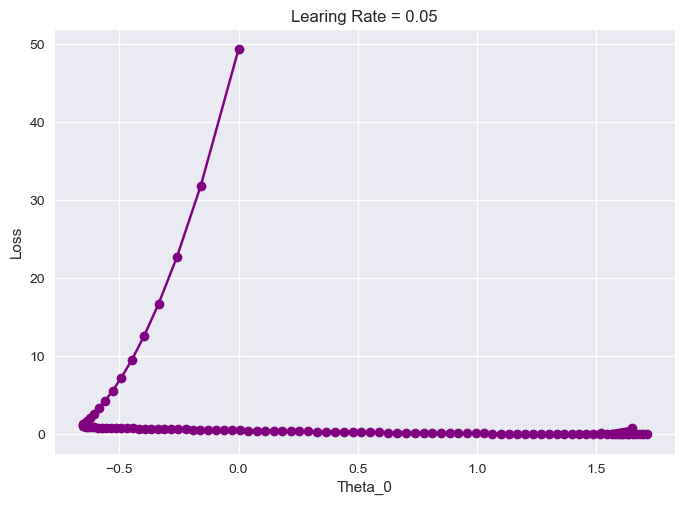

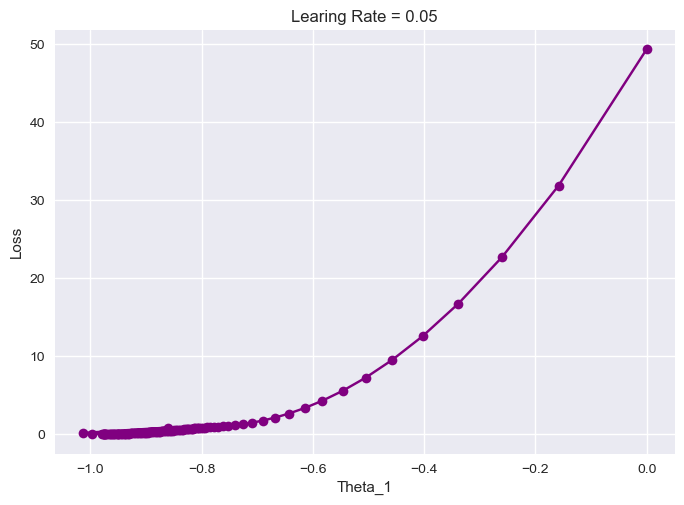

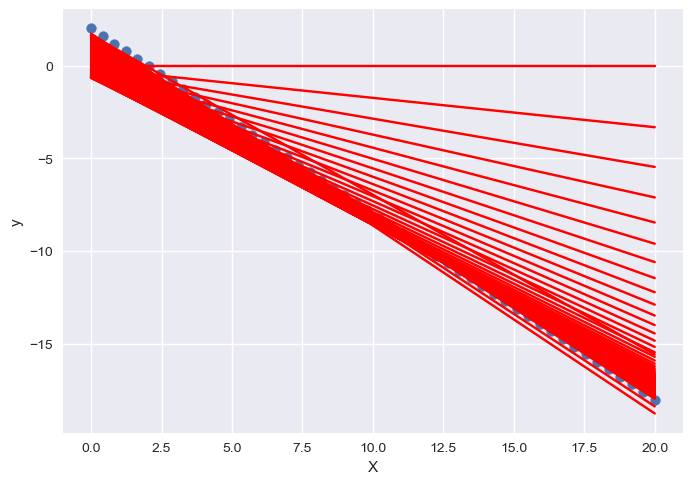

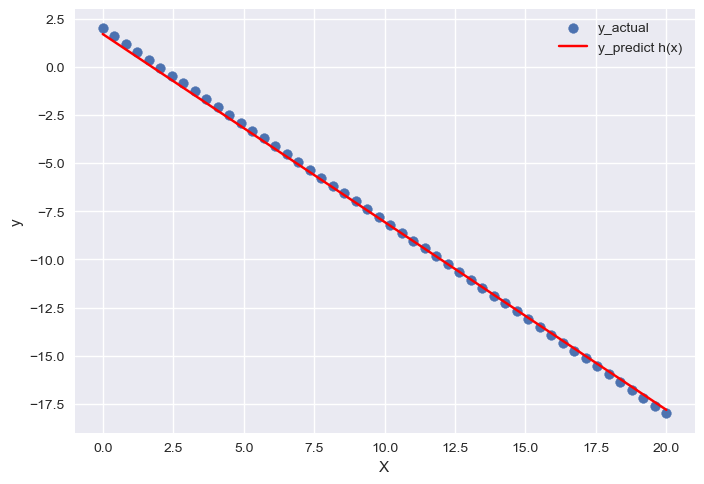

In [ ]:
Epoch_loss(loss)
Thetas_loss(Theta_0,Theta_1,loss,0.05)
All_lines(X,y,H)
best_Line(X,y,H[-1])

##### The following results uses alpha = 0.005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
Theta_0, Theta_1 , H ,  loss = RMSProp(X,y, 0.005 , 0.9, 1e-8 , 5000)


****************** Iteration 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j =  49.34693877551021

Gradient Vector :
 [[  8.        ]
 [114.69387755]]

Gradient Vector Norm :
 114.97254258164628

theta_0_new :  -0.0158113882383419
theta

In [ ]:
r2_score(y,H[-1])

0.9948527070941069

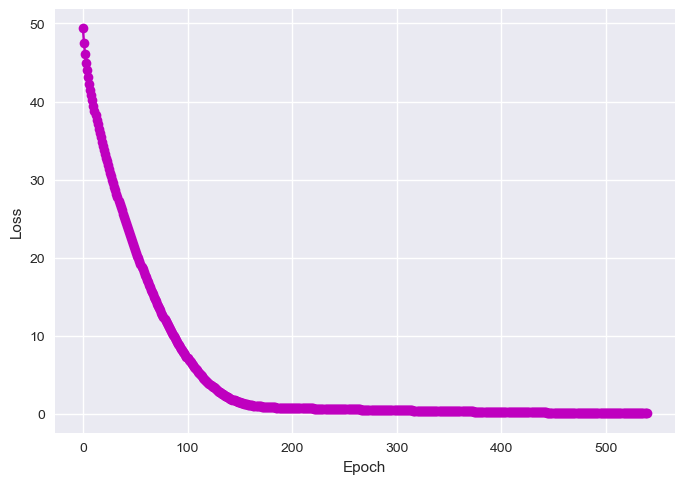

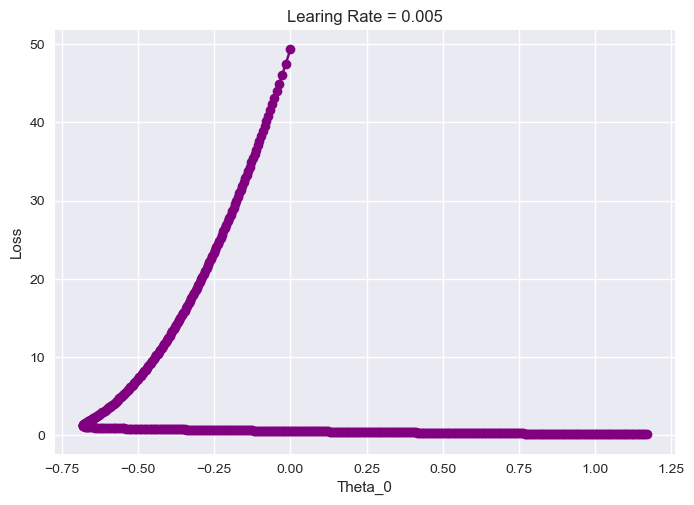

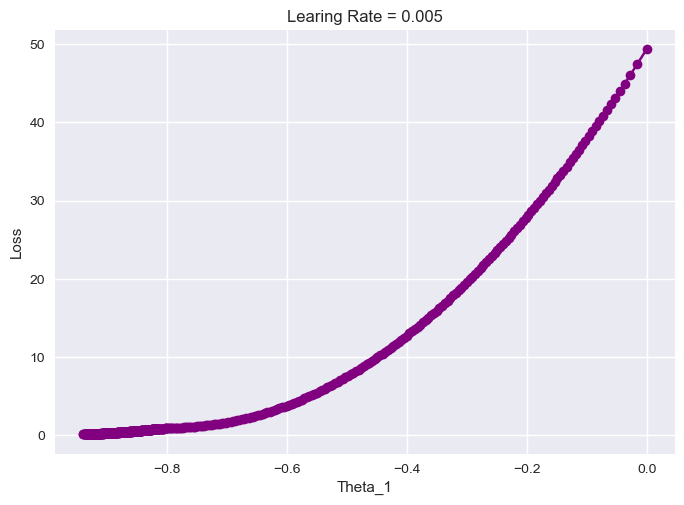

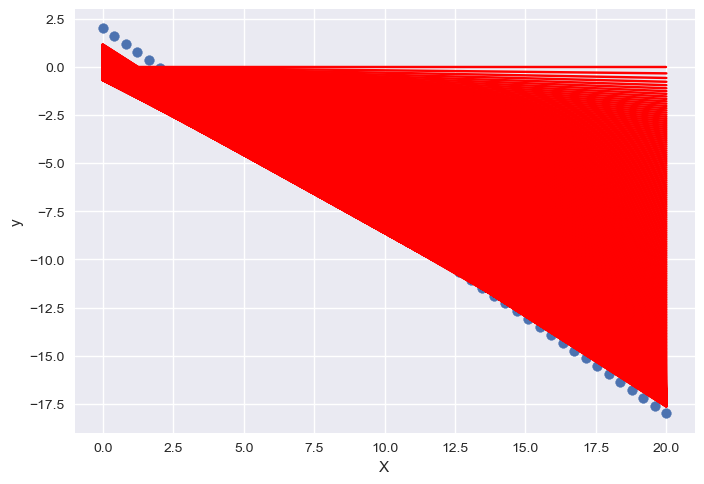

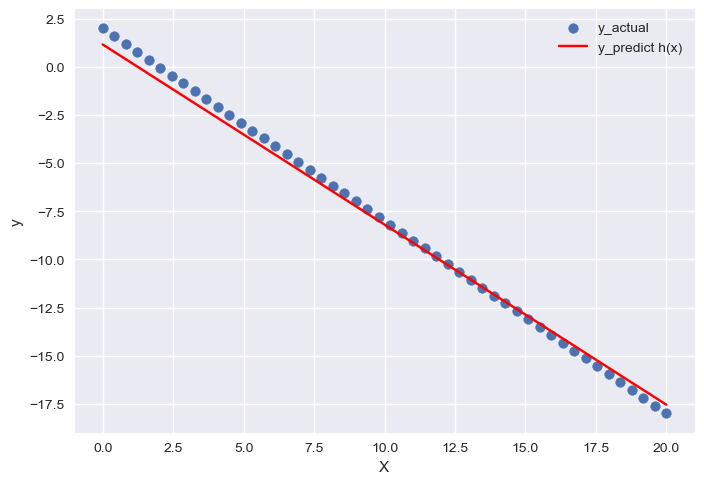

In [ ]:
Epoch_loss(loss)
Thetas_loss(Theta_0,Theta_1,loss,0.005)
All_lines(X,y,H)
best_Line(X,y,H[-1])

##### The following results uses alpha = 0.0005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
Theta_0, Theta_1 , H ,  loss = RMSProp(X,y, 0.0005 , 0.9, 1e-8 , 5000)


****************** Iteration 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
 [-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j =  49.34693877551021

Gradient Vector :
 [[  8.        ]
 [114.69387755]]

Gradient Vector Norm :
 114.97254258164628

theta_0_new :  -0.00158113882383419
thet

In [ ]:
r2_score(y,H[-1])

0.9476184845511563

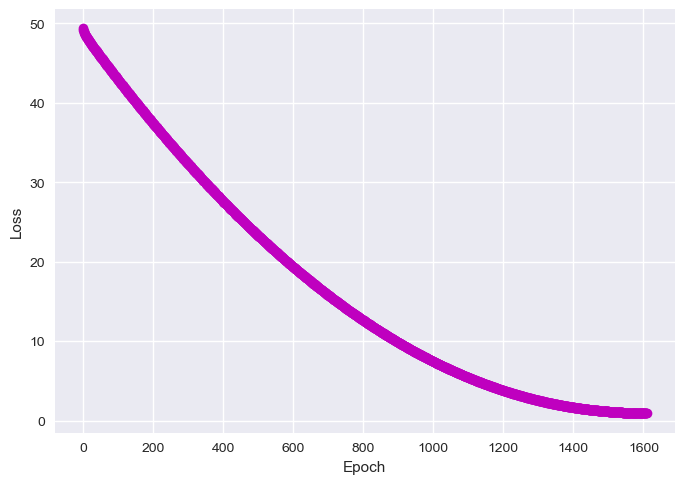

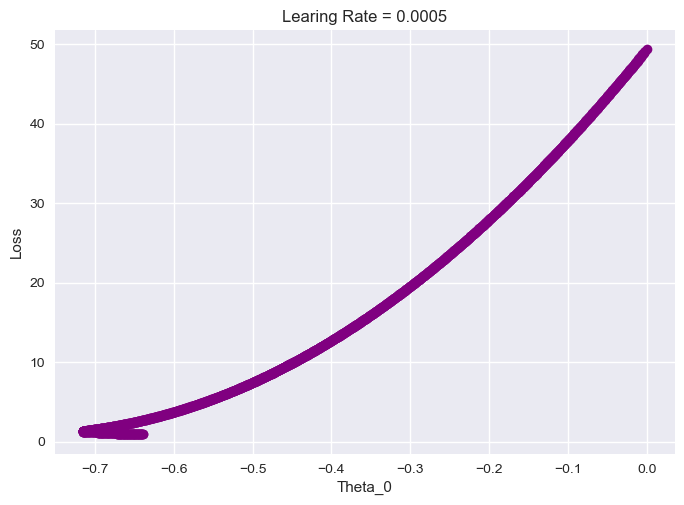

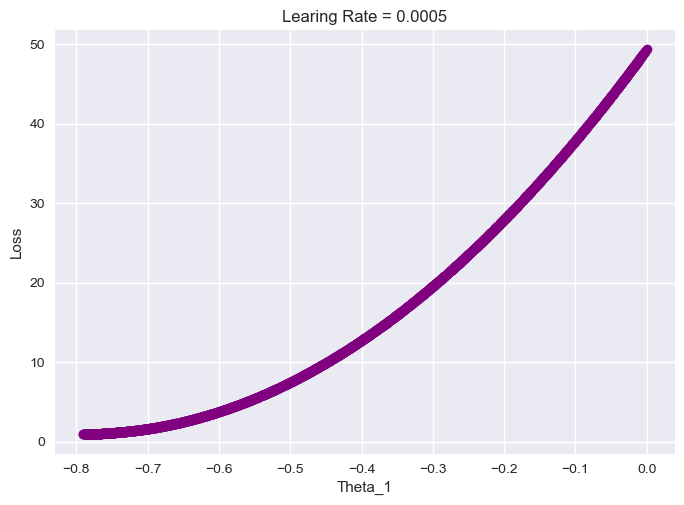

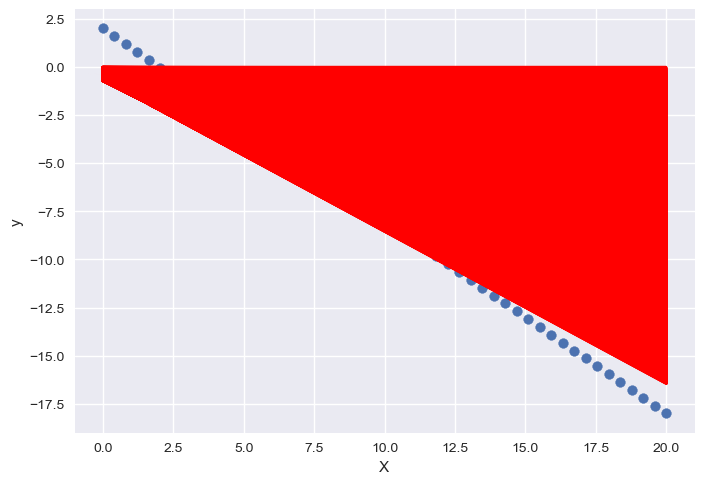

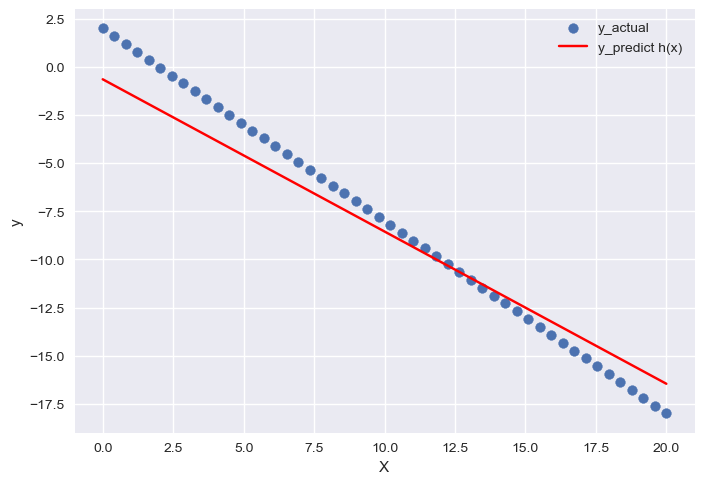

In [ ]:
Epoch_loss(loss)
Thetas_loss(Theta_0,Theta_1,loss,0.0005)
All_lines(X,y,H)
best_Line(X,y,H[-1])